<a href="https://colab.research.google.com/github/VuongTuanKhanh/Funix-Capstone-Project/blob/main/notebooks/End-to-end%20YOLOv5%20with%20AOT%20Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src="https://user-images.githubusercontent.com/26833433/125273437-35b3fc00-e30d-11eb-9079-46f313325424.png">

This is the **official notebook 🚀** by [Tuan Khanh](https://github.com/VuongTuanKhanh), and is freely available for redistribution under the [MIT license](https://opensource.org/licenses/MIT). 

This tutorial will help you build objects detections models easily in the cloud with **GPU** enabled so that you can run real-time object detections as well as train your very own custom object detector!

First of all, you will need to enable **GPU** acceleration within your **Colab Notebook** so that your system will be able to process detections over 100 faster than **CPU**.

<details>

- Click **Edit** at top left of your notebook

![image.png](https://raw.githubusercontent.com/VuongTuanKhanh/Funix-Capstone-Project/main/images/gpu_1.png)

- Click **Notebook Settings** within dropdown

![image.png](https://raw.githubusercontent.com/VuongTuanKhanh/Funix-Capstone-Project/main/images/gpu_2.png)

- Under 'Hardware Accelerator' select **GPU** and then hit **Save**

![image.png](https://raw.githubusercontent.com/VuongTuanKhanh/Funix-Capstone-Project/main/images/gpu_3.png)

Your notebook should now have GPU enabled!

</details>

For more information please visit https://github.com/VuongTuanKhanh/Funix-Capstone-Project. Thank you!

# Before You Start

## Google Drive Setup

In [ ]:
import os, sys
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"]=25,25
from IPython.display import clear_output

# Check the ipython interpreter is being used
if 'google.colab' in str(get_ipython()):
    # Import Library
    from google.colab import drive
    # Mounting Drive Folder
    try:
        drive.mount('/content/drive')
    except:
        print("Mounting Fail")
    else:
        print("Mouting Success")
    finally:
        print("Mounting process is completed")

    # Define the path to the Google Drive Folder
    drive_path = "/content/drive/MyDrive/Funix-Capstone-Project"

    # Clone the repo if the folder whether it is not existed
    if not os.path.exists(drive_path):
        # Install 'git' module if needed
        try:
            from git import Repo
        except ModuleNotFoundError:
            import sys, subprocess
            print("Installing 'git' module")
            subprocess.check_call([sys.executable, '-m', 'pip', 'install', 'gitpython'])

        # Import 'repo' from 'git' module
        from git import Repo
        # Create project folder
        os.mkdir(drive_path)
        # Clone the repo
        Repo.clone_from("https://github.com/VuongTuanKhanh/Funix-Capstone-Project", drive_path)
        print("Cloning git repo")


    # Navigate to the folder
    os.chdir(drive_path)

Mounted at /content/drive
Mouting Success
Mounting process is completed


## Clone root Github Repo

Clone this repo, and install `requirements.txt` dependencies, including **Python>=3.8** and **PyTorch>=1.7**

In [ ]:
# Clone ultralytics YOLOv5
!git clone https://github.com/ultralytics/yolov5
# Navigate to YOLOv5 folder
os.chdir("yolov5")
# Install the required dependences
%pip install -qr requirements.txt

# Import Pytorch
import torch
from IPython.display import Image, clear_output

# Clear output console
clear_output()

# Print out the working enviroment
print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

## Dataset Preparation and some Tips for creating best model

This tutorial is the next in my series of notebooks. Data setup and directory structure have been described in previous sections. You can refer to how to download and process data [here](https://github.com/VuongTuanKhanh/Funix-Capstone-Project/blob/main/notebooks/Dataset_EDA_and_Download.ipynb).

For the best result, you should consider the followings factors:
- **Images per class**: ≥1.5k images per class
- **Instances per class**: ≥10k instances (labeled objects) per class total
- **Image variety**: Must be representative of deployed environment. For real-world use cases we recommend images from different times of day, different seasons, different weather, different lighting, different angles, different sources (scraped online, collected locally, different cameras) etc.
- **Label consistency**: All instances of all classes in all images must be labelled. Partial labelling will not work.
- **Label accuracy**: Labels must closely enclose each object. No space should exist between an object and it's bounding box. No objects should be missing a label.
- **Background images**: Background images are images with no objects that are added to a dataset to reduce **False Positives (FP)**. We recommend about 0-10% background images to help reduce **FPs**.

Before modifying anything, first train with default settings to establish a performance baseline. A full list of train.py settings can be found in the train.py argparser.

- **Epochs**: Start with 300 epochs. If this overfits early then you can reduce epochs. If overfitting does not occur after 300 epochs, train longer, i.e. 600, 1200 etc epochs.
- **Image size**: Due to the high amount of small objects in the dataset it can benefit from training at higher resolutions such as `--img 1280`. If there are many small objects then custom datasets will benefit from training at native or higher resolution. Best inference results are obtained at the same --img as the training was run at, i.e. if you train at `--img 1280` you should also test and detect at `--img 1280`.
- **Batch size**: Use the largest `--batch-size` that your hardware allows for. Small batch sizes produce poor batchnorm statistics and should be avoided.
- **Hyperparameters**: Default hyperparameters are in `hyp.scratch.yaml`. We recommend you train with default hyperparameters first before thinking of modifying any. In general, increasing augmentation hyperparameters will reduce and delay overfitting, allowing for longer trainings and higher final **mAP**. Reduction in loss component gain hyperparameters like `hyp['obj']` will help reduce overfitting in those specific loss components.

## Create Training Data and Labels

After using a tool like **CVAT**, **makesense.ai** or **Labelbox** to label your images, export your labels to **YOLO** format, with one `*.txt` file per image (if no objects in image, no `*.txt` file is required). The `*.txt` file specifications are:

- One row per object
- Each row is class `x_center y_center width height` format.
- Box coordinates must be in normalized xywh format (from 0 - 1). If your boxes are in pixels, divide x_center and width by image width, and y_center and height by image height.
- Class numbers are `zero-indexed` (start from 0).

Our data has been clearly defined on the previous parts, so now we jus need to copy and paste them to the new location.

In [ ]:
# Copy the dataset from the previous location
!cp -a ../darknet/data/obj ./data/

## Create dataset.yaml

This is the configurations for our model.

In [ ]:
%%file ./data/aot.yaml
path: ../darknet/data/obj
train: train.txt 
val: train.txt 
test: test.txt
nc: 2
names: [ 'Airplane', 'Helicopter' ]

Writing ./data/aot.yaml


## Select a model

Select a pretrained model to start training from. Here we select **YOLOv5s**, the smallest and fastest model available.

<center>

![](https://github.com/VuongTuanKhanh/Funix-Capstone-Project/blob/main/images/model_comparison.png?raw=true)

</center>

# Training our YOLOv5 model on AOT Dataset

Train a **YOLOv5s** model on **AOT** by specifying `dataset`, `batch-size`, `image size` and either pretrained `--weights yolov5s.pt` (recommended), or randomly initialized `--weights --cfg yolov5s.yaml` (not recommended). Pretrained weights are auto-downloaded from the latest **YOLOv5** release.

All training results are saved to `runs/train/` with incrementing run directories, i.e. `runs/train/exp2`, `runs/train/exp3`, etc.

If something happen that interupt the training process, then you can continue to train from where you left off with the following command:

```python
# Automatically find latest checkpoint - Continue training from where you left off
!python train.py --resume
```

**NOTE**: The visualization for the training process can be found via [Local Logging Notebook](https://github.com/VuongTuanKhanh/Funix-Capstone-Project/blob/main/notebooks/YOLOv5_Evaluation_with_Local_Logging.ipynb) or via [WanDB Live Visualization](https://wandb.ai/vuongtuankhanh/YOLOv5/reports/YOLOv5-on-Airborne-Object-Tracking-dataset--Vmlldzo5ODkxNjg).

## Baseline - Starting from scratch with default settings and small Image Resolution

In [ ]:
# First time training
!python train.py --img 480 --batch 8 --epochs 50 --data aot.yaml --weights '' --cfg yolov5s.yaml

100% 755k/755k [00:00<00:00, 36.0MB/s]
train: weights=, cfg=yolov5s.yaml, data=aot.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=50, batch_size=8, imgsz=480, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 2021-9-1 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, 

## Improve Baseline with pretrained weight from YOLOv5s

In [ ]:
# First time training
!python train.py --img 640 --batch 8 --epochs 50 --data aot.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=, data=aot.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=50, batch_size=8, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 2021-9-1 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.5, shear=0.0, pers

## Improve Baseline by increasing Image Resolution

In [ ]:
# First time training
!python train.py --img 1024 --batch 16 --epochs 50 --data aot.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=, data=aot.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=50, batch_size=8, imgsz=1024, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
github: Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 3 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (3/3), done.
From https://github.com/ultralytics/yolov5
   234e8ae..fad57c2  master     -> origin/master
YOLOv5 🚀 2021-9-1 torch 1.9.0+cu102

## Improving Baseline with higher Image Resolution, Batch, and Epochs

In [ ]:
# First time training
!python train.py --img 1024 --batch 24 --epochs 300 --data aot.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=, data=aot.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=300, batch_size=24, imgsz=1024, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
github: Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 2021-9-1 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=

## High Image Resolution with low batch and 300 epochs

In [ ]:
# First time training
!python train.py --img 1024 --batch 16 --epochs 300 --data aot.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=, data=data/coco128.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=300, batch_size=16, imgsz=640, rect=False, resume=True, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
github: Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
Resuming training from ./runs/train/exp5/weights/last.pt
YOLOv5 🚀 2021-9-1 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma

## Continue training from our best pretrain weights



In [ ]:
# First time training
!python train.py --img 1024 --batch 16 --epochs 300 --data aot.yaml --weights ./runs/train/exp5/weights/best.pt

train: weights=./runs/train/exp5/weights/best.pt, cfg=, data=aot.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=300, batch_size=16, imgsz=1024, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=30
github: ⚠️ YOLOv5 is out of date by 1 commit. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 2021-9-1 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hs

# Integration with Visualization Tools

## Visualization with Weights & Biases Logging

Think of **W&B** like **GitHub** for machine learning models. With a few lines of code, save everything you need to debug, compare and reproduce your models — architecture, hyperparameters, git commits, model weights, GPU usage, and even datasets and predictions.

**W&B**’s lightweight integrations work with any **Python** script, and you can sign up for a free account and start tracking and visualizing models in 5 minutes.

Used by top researchers including teams at **OpenAI**, **Lyft**, **Github**, and **MILA**, **W&B** is part of the new standard of best practices for machine learning. How **W&B** can help you optimize your machine learning workflows:

- Debug model performance in real time
- GPU usage, visualized automatically
- Custom charts for powerful, extensible visualization
- Share insights interactively with collaborators
- Optimize hyperparameters efficiently
- Track datasets, pipelines, and production models

**Weights & Biases (W&B)** is now integrated with **YOLOv5** for real-time visualization and cloud logging of training runs. This allows for better run comparison and introspection, as well improved visibility and collaboration among team members. To enable **W&B** logging install `wandb`, and then train normally.

In [ ]:
# Install wandb
!pip install wandb
# Clear the output
clear_output()

During training you will see live updates at `https://wandb.ai`, and you can create Detailed Reports of your results using the W&B Reports tool.

Run information streams from your environment to the W&B cloud console as you train. This allows you to monitor and even cancel runs in realtime. All important information is logged:

- Training losses
- Validation losses
- Metrics: Precision, Recall, mAP@0.5, mAP@0.5:0.95
- Learning Rate over time
- GPU: Type, GPU Utilization, power, temperature, CUDA memory usage
- System: Disk I/0, CPU utilization, RAM memory usage
- Environment: OS and Python types, Git repository and state, training command


## Visualization with Tensorboard

Another way of training visualization is using **Tensorboard**. **TensorBoard** provides the visualization and tooling needed for machine learning experimentation:
- Tracking and visualizing metrics such as loss and accuracy
- Visualizing the model graph (ops and layers)
- Viewing histograms of weights, biases, or other tensors as they change over time
- Projecting embeddings to a lower dimensional space
- Displaying images, text, and audio data
- Profiling **TensorFlow** programs
- And much more

In [ ]:
# Tensorboard (optional)
%load_ext tensorboard
# Access the training directory
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

# Model Inference

Here, we will conduct inference through the best model we have trained. We will also perform and evaluate a number of operations at the same time.

## Inference with our trained model using Pytorch Hub

We can use **PyTorch Hub** to load our trained `weights` and create an instance model using that `weights` to do `inference`.

In [ ]:
# Load our model
model = torch.hub.load('./', 'custom', path='./runs/train/exp5/weights/best.pt', source='local')
# Cleaning the output
clear_output()
# Image Path
img = './data/obj/Images/1f91f760265745048d16b9938a44e8a5/15549769457710429351f91f760265745048d16b9938a44e8a5.png'
# Inference
results = model(img)

image 1/1: 2048x2448 1 Helicopter
Speed: 680.7ms pre-process, 37.4ms inference, 2.4ms NMS per image at shape (1, 3, 544, 640)


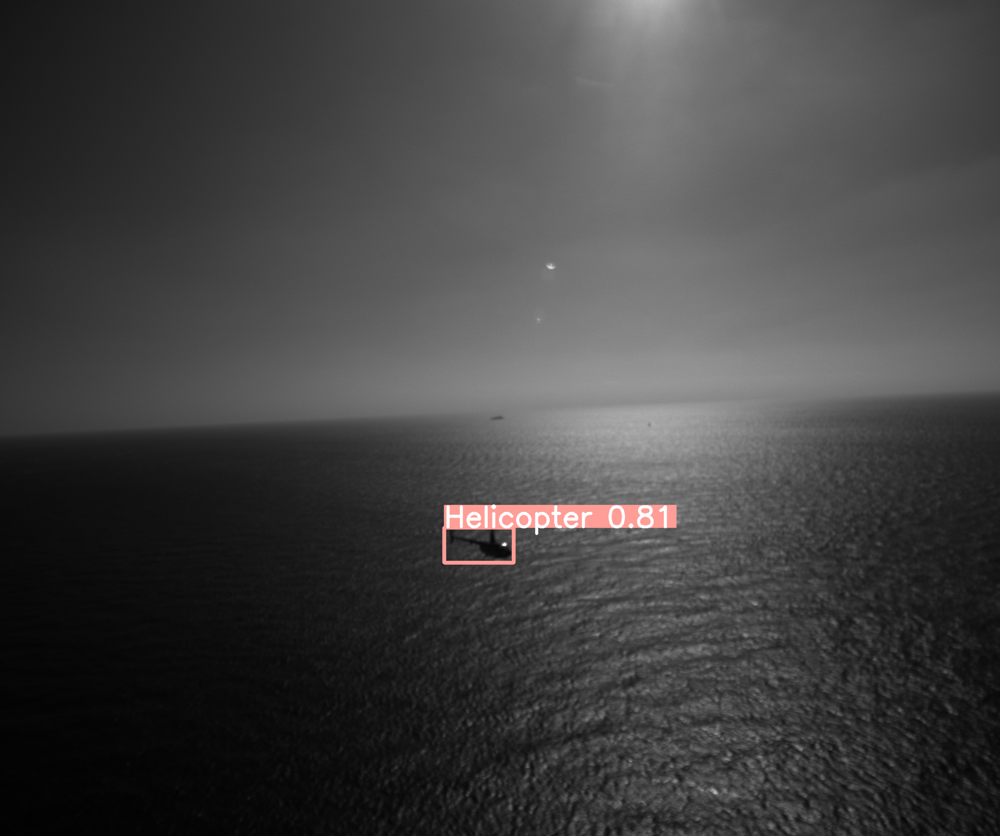

,xmin,ymin,xmax,ymax,confidence,class,name
0,1087.256226,1292.706299,1257.468628,1378.768677,0.808105,1,Helicopter


In [ ]:
# Print out the prediction
results.print()  
# results.save()  

# Return the Tensorflow format
results.xyxy[0]

# Show the labeled image
results.show()

# Return the prediction dataframe
results.pandas().xyxy[0]

## Inference Test Time Augmentation (TTA)

Append `--augment` to any existing `detect.py` command to enable **TTA**, and increase the image size by about 30% for improved results. Note that inference with **TTA** enabled will typically take about 2-3X the time of normal inference as the images are being left-right flipped and processed at 3 different resolutions, with the outputs merged before **NMS**. Part of the speed decrease is simply due to larger image sizes (1024 vs 1331), while part is due to the actual **TTA** operations.

In [ ]:
!python detect.py --weights ./runs/train/exp5/weights/best.pt --img 1024 --source ./data/obj/Images/0bf4b811a508426f87352f0b1b857ef0/15607816817278873280bf4b811a508426f87352f0b1b857ef0.png --augment

detect: weights=['./runs/train/exp5/weights/best.pt'], source=./data/obj/Images/0bf4b811a508426f87352f0b1b857ef0/15607816817278873280bf4b811a508426f87352f0b1b857ef0.png, imgsz=[1024, 1024], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=True, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 2021-9-3 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

Fusing layers... 
Model Summary: 224 layers, 7056607 parameters, 0 gradients, 16.3 GFLOPs
image 1/1 /content/drive/My Drive/Funix-Capstone-Project/yolov5/data/obj/Images/0bf4b811a508426f87352f0b1b857ef0/15607816817278873280bf4b811a508426f87352f0b1b857ef0.png: 864x1024 1 Helicopter, Done. (0.150s)
Results saved to runs/detect/exp4
Done. (0.584s)


**TTA** is automatically integrated into all **YOLOv5 PyTorch Hub** models, and can be accessed by passing `augment=True` at inference time.

In [ ]:
# Inference
results = model(img, augment=True)  # TTA inference

image 1/1: 2048x2448 1 Helicopter
Speed: 120.5ms pre-process, 93.8ms inference, 1.8ms NMS per image at shape (1, 3, 544, 640)


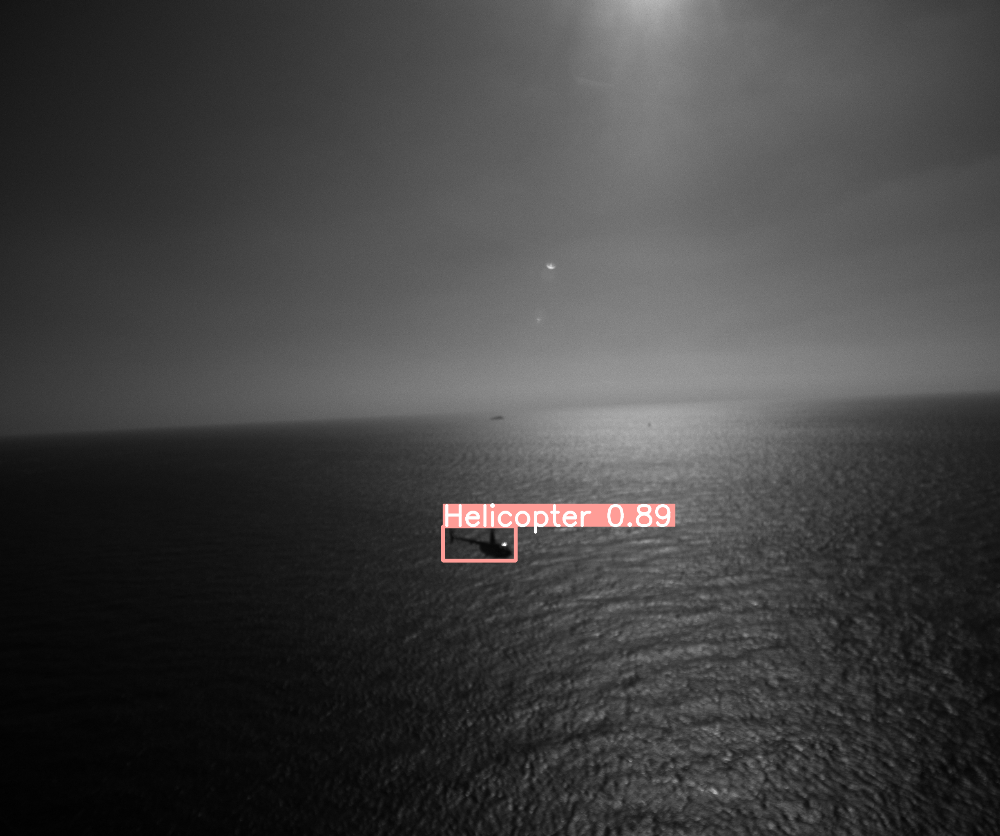

,xmin,ymin,xmax,ymax,confidence,class,name
0,1084.387451,1289.837524,1262.249878,1373.987427,0.893066,1,Helicopter


In [ ]:
# Print out the prediction
results.print()  
# results.save()  

# Return the Tensorflow format
results.xyxy[0]

# Show the labeled image
results.show()

# Return the prediction dataframe
results.pandas().xyxy[0]

## Model Ensembling

**Ensemble Modeling** is a process where multiple diverse models are created to predict an outcome, either by using many different modeling algorithms or using different training data sets. The ensemble model then aggregates the prediction of each base model and results in once final prediction for the unseen data. The motivation for using ensemble models is to reduce the generalization error of the prediction. As long as the base models are diverse and independent, the prediction error of the model decreases when the ensemble approach is used. The approach seeks the wisdom of crowds in making a prediction. Even though the ensemble model has multiple base models within the model, it acts and performs as a single model.

In [ ]:
!python detect.py --weights ./runs/train/exp4/weights/best.pt ./runs/train/exp5/weights/best.pt --img 1024 --source ./data/obj/Images/004474050bdc46c2805ae42048c24c2f/1557924349840482376004474050bdc46c2805ae42048c24c2f.png

detect: weights=['./runs/train/exp4/weights/best.pt', './runs/train/exp5/weights/best.pt'], source=./data/obj/Images/004474050bdc46c2805ae42048c24c2f/1557924349840482376004474050bdc46c2805ae42048c24c2f.png, imgsz=[1024, 1024], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
YOLOv5 🚀 2021-9-3 torch 1.9.0+cu102 CUDA:0 (Tesla K80, 11441.1875MB)

Fusing layers... 
Model Summary: 224 layers, 7056607 parameters, 0 gradients, 16.3 GFLOPs
Fusing layers... 
Model Summary: 224 layers, 7056607 parameters, 0 gradients, 16.3 GFLOPs
Ensemble created with ['./runs/train/exp4/weights/best.pt', './runs/train/exp5/weights/best.pt']

image 1/1 /content/drive/My Drive/Funix-Capstone-Project/yolov5/data/obj/Images/004474050bdc46c28

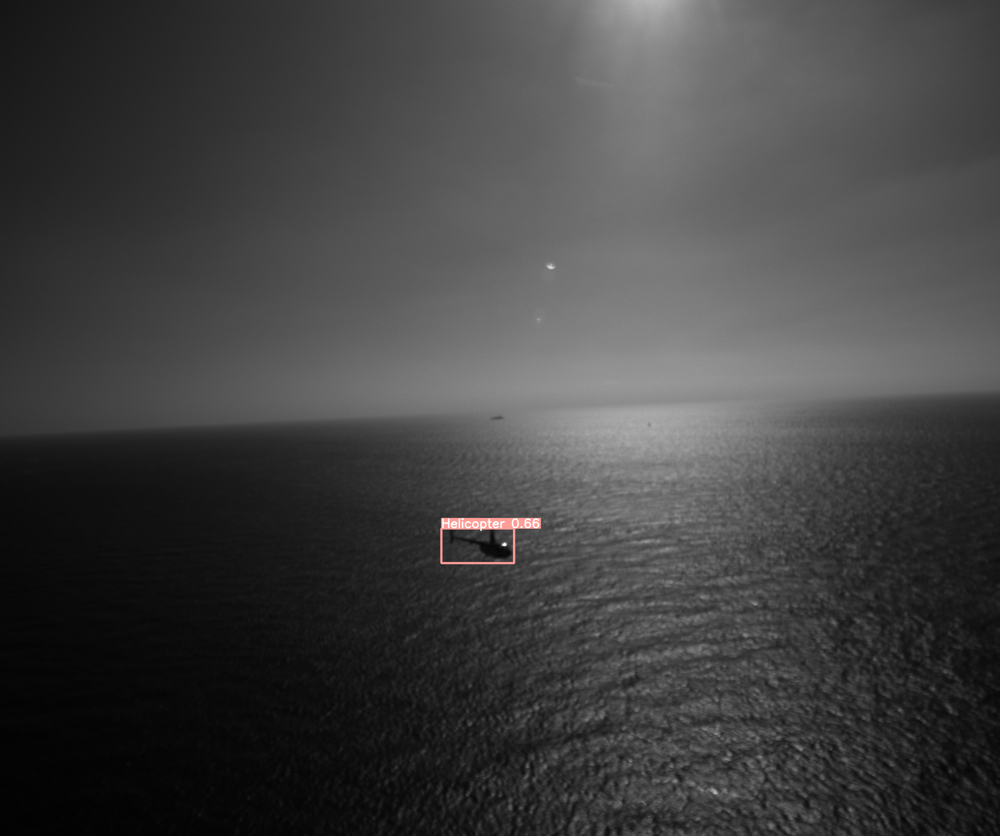

In [ ]:
Image("./runs/detect/exp5/1557924349840482376004474050bdc46c2805ae42048c24c2f.png")

## Model Pruning/Sparsity

**Pruning** is a technique in **Deep Learning** that aids in the development of smaller and more efficient neural networks. It's a model optimization technique that involves eliminating unnecessary values in the `weight` tensor. In this section, we will try prun `model` and evaluate its accuracy and `inference` speed.

image 1/1: 2048x2448 1 Helicopter
Speed: 120.0ms pre-process, 32.8ms inference, 2.0ms NMS per image at shape (1, 3, 544, 640)


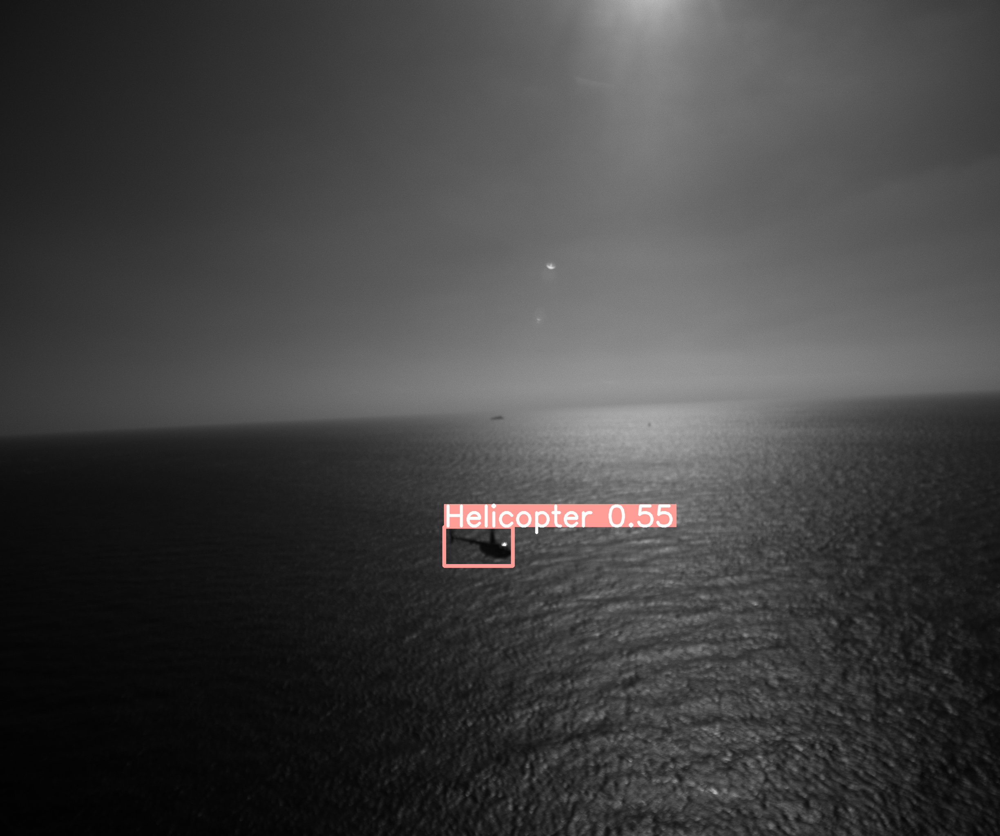

,xmin,ymin,xmax,ymax,confidence,class,name
0,1087.256226,1290.793701,1255.556152,1386.418701,0.552734,1,Helicopter


In [ ]:
# Prun our model in half
model.half()

from utils.torch_utils import prune
prune(model, 0.3)

results = model(img)

# Print out the prediction
results.print()  
# results.save()  

# Return the Tensorflow format
results.xyxy[0]

# Show the labeled image
results.show()

# Return the prediction dataframe
results.pandas().xyxy[0]

# Export our best Trained YOLOv5 Model

This command exports a pretrained model to **ONNX**, **TorchScript** and **CoreML** formats. The three exported models will be saved alongside the original **PyTorch** model

In [ ]:
# This command exports a pretrained model to ONNX, TorchScript and CoreML formats.
!python export.py --weights ./runs/train/exp5/weights/best.pt --img 1024 --batch 8

In [ ]:
import os
os.listdir("./runs/train/exp5/weights")

['last.pt', 'best.pt', 'best.torchscript.pt', 'best.onnx', 'best.mlmodel']

# Visualizing Exported Model with Netron Viewer

**Netron** is a viewer for neural network, deep learning and machine learning models.

**Netron** supports **ONNX**, **TensorFlow Lite**, **Keras**, **Caffe**, **Darknet**, **ncnn**, **MNN**, **PaddlePaddle**, **Core ML**, **MXNet**, **RKNN**, **MindSpore Lite**, **TNN**, **Barracuda**, **Tengine**, **TensorFlow.js**, **Caffe2** and **UFF**.

**Netron** has experimental support for **PyTorch**, **TensorFlow**, **TorchScript**, **OpenVINO**, **Torch**, Vitis **AI, Arm NN, BigDL, Chainer, CNTK, Deeplearning4j, MediaPipe, ML.NET** and **scikit-learn**.

```python
# Install Netron Viewer 
!pip install netron
# Import Netron
import netron
# Serving host
netron.start('./runs/train/exp5/weights/best.torchscript.pt')
```

Follow this [link](https://raw.githubusercontent.com/VuongTuanKhanh/Funix-Capstone-Project/main/images/best.torchscript.pt.png) to see the image.

![](https://raw.githubusercontent.com/VuongTuanKhanh/Funix-Capstone-Project/main/images/best.torchscript.pt.png)

# That's it !!!

And that's all we have tried in this project. In the future, we will dig deeper into the problem of abstraction by applying:
- **Hyperparameter Evolution** is a method of **Hyperparameter Optimization using a Genetic Algorithm (GA)** for optimization. **Hyperparameters** in **Machine Learning** control various aspects of training, and finding optimal values for them can be a challenge. Traditional methods like grid searches can quickly become intractable due to 
    - The high dimensional search space 
    - Unknown correlations among the dimensions
    - Expensive nature of evaluating the fitness at each point, making **GA** a suitable candidate for hyperparameter searches.
- **Freeze YOLOv5** 🚀 layers when **Transfer Learning**. **Transfer Learning** is a useful way to quickly retrain a model on new data without having to retrain the entire network. Instead, part of the initial weights are frozen in place, and the rest of the weights are used to compute loss and are updated by the optimizer. This requires less resources than normal training and allows for faster training times, though it may also results in reductions to final trained `accuracy`.

**Thank you for comming all along with us and hope for our greater success in the near future 📚📚📚 !!!**